In [1]:
import os
from openai import OpenAI
from dotenv import load_dotenv
import time
import json
import re
from PIL import Image as PILImage
from io import BytesIO
import requests

from utils import call_openai


In [2]:
STORY_PROMPT = """
Create an engaging story that is rich in visual descriptions. The story should be structured 
with clear scene transitions and vivid imagery. Include detailed descriptions of:
- Characters and their appearances
- Settings and environments
- Actions and movements
- Atmospheric elements (lighting, weather, mood)

The story should be between 500-1000 words.
"""

# Base template for image generation | UNUSED
IMAGE_PROMPT_TEMPLATE = """
{scene_description}, digital art style, dreamy atmosphere, vibrant colors, 
highly detailed, 4k, masterpiece quality, consistent lighting, cinematic composition, 
professional photography, artstation trending
"""

In [3]:
STORY_ABOUT = "A story about a fox who goes on a journey to the arctic to find a friend."

In [4]:
def generate_story(STORY_ABOUT):
    """Generate a story using OpenAI's GPT model"""
    try:
        response = call_openai(STORY_PROMPT, STORY_ABOUT, model="gpt-4o-mini")
        return response
    except Exception as e:
        print(f"Error generating story: {e}")
        return None

In [5]:
from utils import generate_image


STORY_SPLIT_PROMPT = """
You are a storyboarding expert. You are given a story and you need to split it into segments.

I want you to split the story into segments of 100-200 words each.

You will be given a story, and you split it, and return the segments along with the prompt for the image.


Some suggestions for the image prompts:
- DO not include any names
- Always explain what you are trying to generate
- You can repeat things if they are important
- Always mention what the creature is: a human, a fox, a cat, a dog, etc.
- Make sure the tone and the emotion of the image is consistent with the story segment.


You have to come up with amazing prompts for the images that goes with the story and the story segments.

You have to output in a json format.
You must always stick to this given format.

Format:
[
    {
        "story_segment": "...",
        "image_prompt": "..."
    },
    ...
]

Remember to always stick to this format.


Keep the prompts somewhat consistent, similar tones, you can obviously deviate from the prompt if the environment is different.


DO your best, give out comprehensive prompts. - ATLEAST 50 words.


YOU MUST OUTPUT THE JSON DIRECTLY.
DO NOT PREPEND IT WITH ```json OR ANYTHING ELSE.

Start with [ and end with ]. Output the json directly, otherwise it will be rejected.


"""


def split_story_into_segments(story):
    response = call_openai(STORY_SPLIT_PROMPT, f"Split this story and return the segments in the format given above. {story} ", model="gpt-4o-mini")
    return response




def generate_images(story_segments):
    for i, segment in enumerate(story_segments):
        image_prompt = segment["image_prompt"]
        image_url = generate_image(image_prompt)
        
        # Create outputs directory if it doesn't exist
        os.makedirs("outputs", exist_ok=True)
        
        # Download and save the image
        response = requests.get(image_url)
        if response.status_code == 200:
            image_path = f"outputs/image_{i+1}.png"
            with open(image_path, "wb") as f:
                f.write(response.content)
            segment["image_path"] = image_path


In [6]:
os.makedirs("outputs", exist_ok=True)

# story = generate_story(STORY_ABOUT)
# with open("outputs/story.txt", "w") as f:
#     f.write(story)

story = open("outputs/story.txt", "r").read()
print(story)

story_segments = split_story_into_segments(story)

json_story_segments = json.loads(story_segments)

print(json_story_segments)
# Save story segments to JSON file

with open("outputs/story_segments.json", "w") as f:
    f.write(json.dumps(json_story_segments, indent=4))


generate_images(json_story_segments)



**Title: The Fox's Arctic Quest**

**Scene 1: The Forest of Whispers**

In the heart of the Forest of Whispers, where the trees stood tall like ancient sentinels, a vibrant orange fox named Finn darted through the underbrush. His fur glistened like molten copper under the dappled sunlight that filtered through the emerald leaves. Finn’s bright, inquisitive eyes sparkled with mischief, and his bushy tail flicked playfully behind him as he navigated the maze of ferns and wildflowers.

The forest was alive with the sounds of chirping birds and rustling leaves, a symphony of nature that filled the air with a sense of adventure. Finn paused at a sun-drenched clearing, where the golden rays illuminated a patch of daisies swaying gently in the breeze. He took a deep breath, inhaling the sweet scent of blooming honeysuckle, when a sudden thought struck him like a bolt of lightning.

His dear friend, Luna, a snowy owl with feathers as white as freshly fallen snow, had flown north to the Arctic 

Generated Story with Images:


Segment 1:
--------------------------------------------------------------------------------
In the heart of the Forest of Whispers, where the trees stood tall like ancient sentinels, a vibrant orange fox named Finn darted through the underbrush. His fur glistened like molten copper under the dappled sunlight that filtered through the emerald leaves. Finn’s bright, inquisitive eyes sparkled with mischief, and his bushy tail flicked playfully behind him as he navigated the maze of ferns and wildflowers. The forest was alive with the sounds of chirping birds and rustling leaves, a symphony of nature that filled the air with a sense of adventure. Finn paused at a sun-drenched clearing, where the golden rays illuminated a patch of daisies swaying gently in the breeze. He took a deep breath, inhaling the sweet scent of blooming honeysuckle, when a sudden thought struck him like a bolt of lightning. His dear friend, Luna, a snowy owl with feathers as white as fr

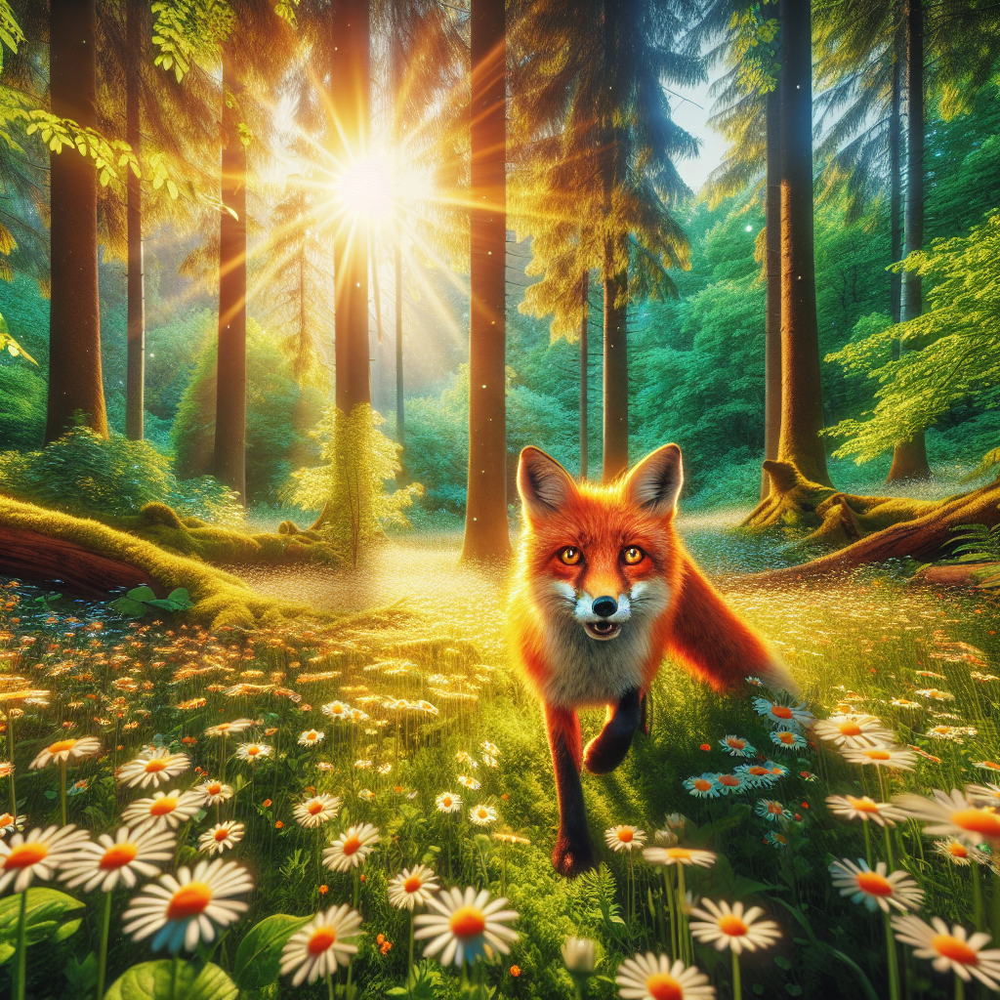




Segment 2:
--------------------------------------------------------------------------------
As Finn set off, the forest began to thin, and the air grew cooler. The trees transformed into slender birches, their white bark gleaming like polished marble against the backdrop of a cobalt sky. The ground beneath his paws became a tapestry of soft moss and scattered pebbles, leading him toward the edge of the world he knew. With each step, the landscape shifted. The sun dipped lower, casting long shadows that danced around him. Finn’s heart raced with excitement and trepidation as he crossed into the unknown. The wind whispered secrets of the Arctic, and he could almost hear Luna’s voice calling him forward.
--------------------------------------------------------------------------------


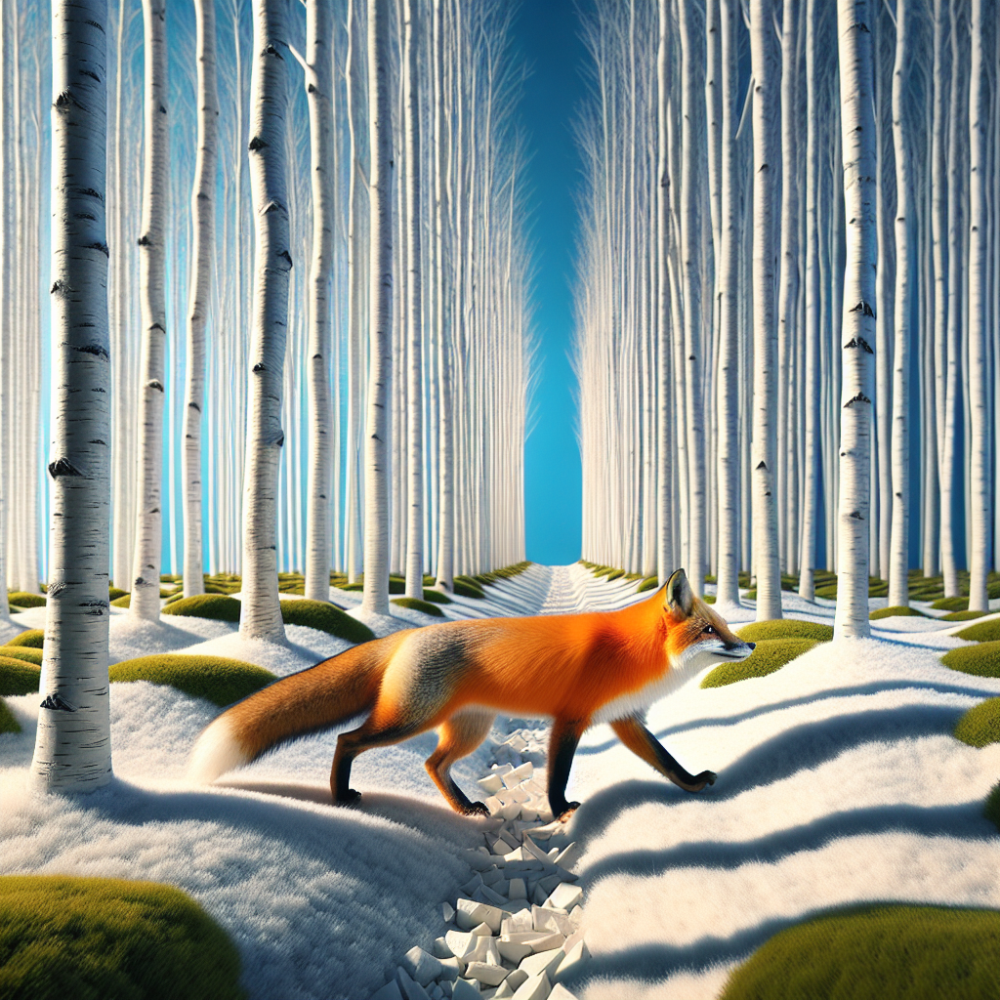




Segment 3:
--------------------------------------------------------------------------------
After days of travel, Finn finally reached the Arctic. The landscape was a breathtaking expanse of white, where the ground sparkled like a million diamonds under the midday sun. The air was crisp and biting, each breath a cloud of mist that hung momentarily before vanishing into the ether. Finn’s paws sank into the soft snow, leaving a trail of delicate prints behind him. In the distance, he spotted a shimmering ice cave, its entrance framed by icicles that glistened like chandeliers. Finn approached cautiously, his heart pounding with anticipation. As he entered the cave, the light refracted through the ice, casting a kaleidoscope of colors on the walls, transforming the cold space into a magical realm.
--------------------------------------------------------------------------------


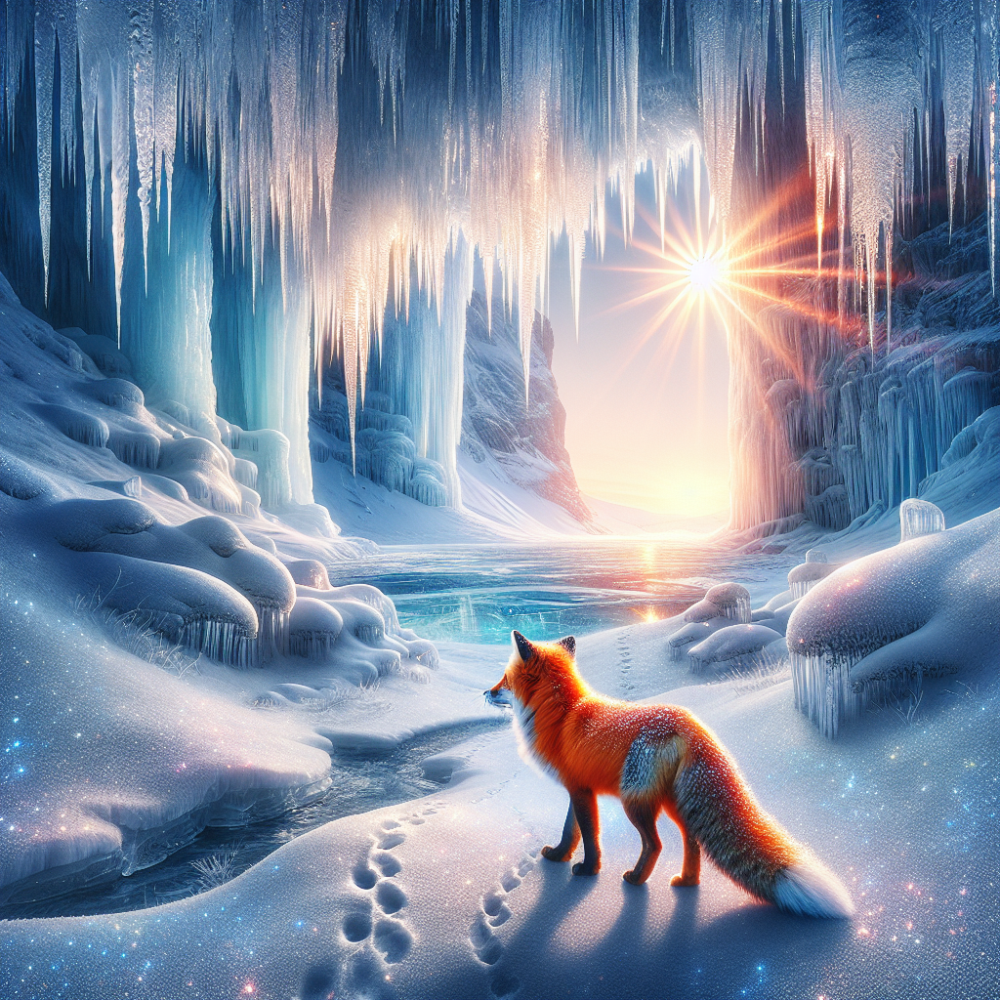




Segment 4:
--------------------------------------------------------------------------------
Inside the cave, Finn’s breath caught in his throat. There, perched majestically on a frozen ledge, was Luna. Her feathers glowed with an ethereal light, and her large, amber eyes sparkled with recognition. “Finn!” she hooted, her voice echoing softly in the cavern. “You made it!” Finn’s heart soared as he bounded toward her, his paws slipping slightly on the icy floor. “I had to find you! I missed you so much!” he exclaimed, his voice filled with warmth despite the chill surrounding them. Luna fluffed her feathers, a smile spreading across her beak. “I’m so glad you’re here! The Arctic is beautiful, but it can be lonely without friends.” She spread her wings wide, revealing the intricate patterns of her feathers, each one a testament to the beauty of the wild.
--------------------------------------------------------------------------------


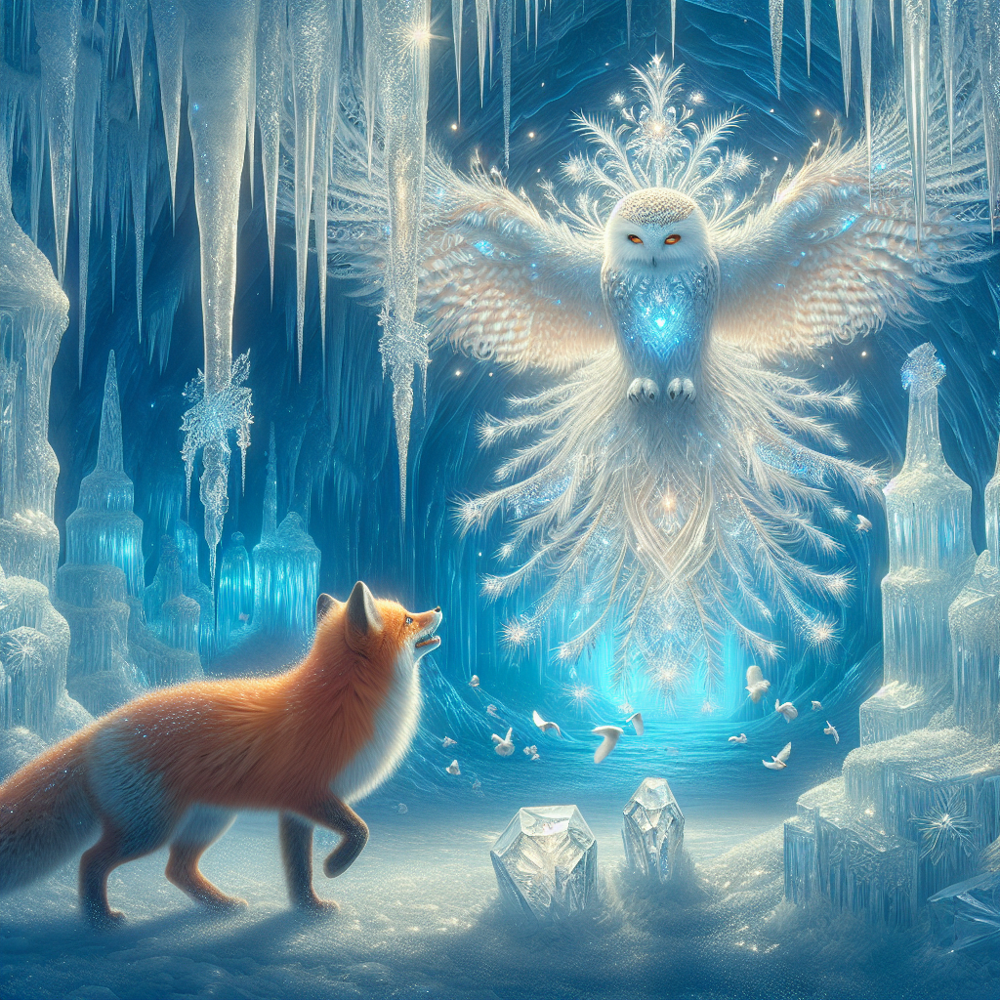




Segment 5:
--------------------------------------------------------------------------------
Together, they ventured out of the cave, the sun now low on the horizon, painting the sky in hues of pink and orange. The world around them transformed into a canvas of colors, the snow reflecting the sunset like a shimmering blanket of silk. Finn and Luna explored the vast tundra, their laughter mingling with the crisp air. They chased each other through the snowdrifts, Finn leaping and bounding with the grace of a dancer, while Luna soared above, her wings catching the wind. They discovered hidden ice formations that sparkled like jewels and watched as the stars began to twinkle in the twilight sky, each one a beacon of hope and friendship.
--------------------------------------------------------------------------------


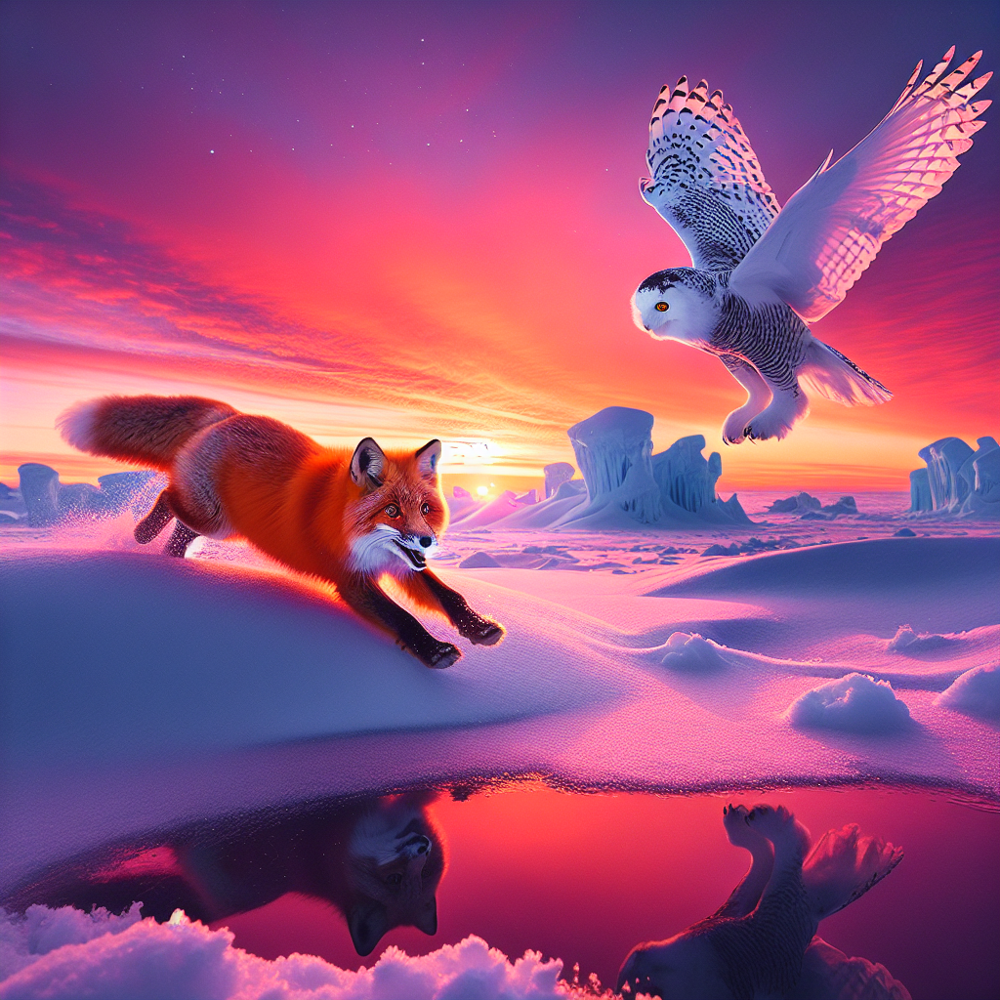




Segment 6:
--------------------------------------------------------------------------------
As night fell, the Arctic sky transformed into a tapestry of stars, the Northern Lights dancing overhead in waves of green and purple. Finn and Luna sat side by side, their hearts full of joy. The cold air wrapped around them like a comforting blanket, and the world felt alive with possibilities. “Thank you for coming, Finn,” Luna said softly, her voice barely above a whisper. “This place is magical, but it’s even more so with you here.” Finn smiled, his heart swelling with gratitude. “I would travel anywhere for you, Luna. You’re my best friend.” In that moment, under the shimmering auroras, Finn realized that the journey was not just about finding Luna; it was about the bond they shared, a friendship that could weather any storm, even the coldest of winters. Together, they would explore the Arctic and create memories that would last a lifetime, their laughter echoing through the frozen expa

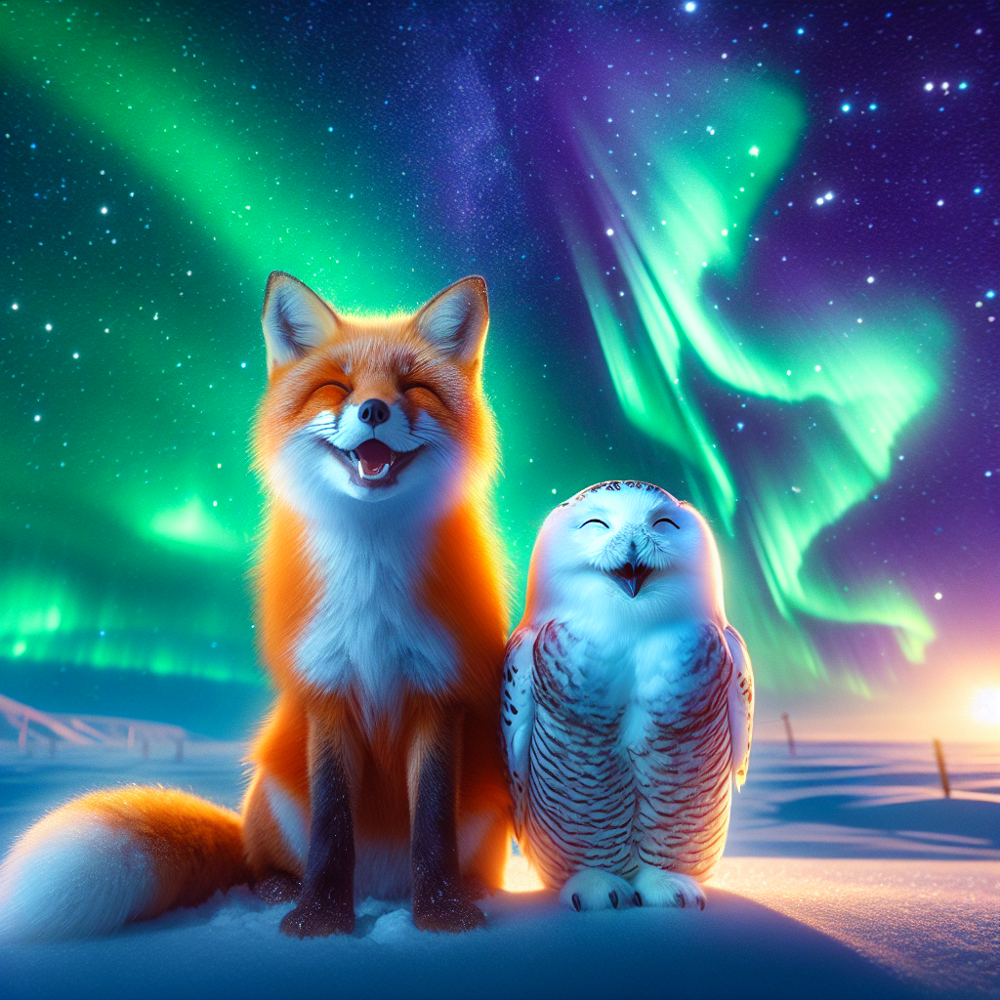

In [8]:
# Display the story segments and images
from utils import generate_audio
from IPython.display import Audio


print("Generated Story with Images:\n")

for i, segment in enumerate(json_story_segments):
    print(f"\nSegment {i+1}:")
    print("-" * 80)
    print(segment["story_segment"])
    print("-" * 80)
    
    # Display image if available
    if "image_path" in segment:
        try:
            # Open and display image using PIL
            image = PILImage.open(segment["image_path"])
            display(image)
        except Exception as e:
            print(f"Error displaying image for segment {i+1}: {e}")
    else:
        print("No image generated for this segment")
        
    # Generate and display audio
    try:
        audio_file_path = generate_audio(segment["story_segment"], f"audio_{i+1}")
        display(Audio(audio_file_path))
    except Exception as e:
        print(f"Error generating audio for segment {i+1}: {e}")
    
    print("\n" + "="*80 + "\n")
